In [1]:
#Basic Library 
import numpy as np 
import pandas as pd 
import math
import scipy 

#Visualization
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.gridspec as gridspec
from IPython.display import display
from PIL import Image
import missingno as msno

import warnings
warnings.filterwarnings("ignore")
sns.set_style("whitegrid")

In [2]:
df=pd.read_csv('https://raw.githubusercontent.com/dsrscientist/bigdatamart_rep/master/bigdatamart_Train.csv')
pd.set_option('Display.max_rows',None)
df

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,NaN,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4710.5350


In [3]:
df.shape

(8523, 12)

In [4]:
df.describe()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
count,7060.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,12.857645,0.066132,140.992782,1997.831867,2181.288914
std,4.643456,0.051598,62.275067,8.371760,1706.499616
min,4.555000,0.000000,31.290000,1985.000000,33.290000
25%,8.773750,0.026989,93.826500,1987.000000,834.247400
50%,12.600000,0.053931,143.012800,1999.000000,1794.331000
75%,16.850000,0.094585,185.643700,2004.000000,3101.296400
max,21.350000,0.328391,266.888400,2009.000000,13086.964800


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8523 entries, 0 to 8522
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            8523 non-null   object 
 1   Item_Weight                7060 non-null   float64
 2   Item_Fat_Content           8523 non-null   object 
 3   Item_Visibility            8523 non-null   float64
 4   Item_Type                  8523 non-null   object 
 5   Item_MRP                   8523 non-null   float64
 6   Outlet_Identifier          8523 non-null   object 
 7   Outlet_Establishment_Year  8523 non-null   int64  
 8   Outlet_Size                6113 non-null   object 
 9   Outlet_Location_Type       8523 non-null   object 
 10  Outlet_Type                8523 non-null   object 
 11  Item_Outlet_Sales          8523 non-null   float64
dtypes: float64(4), int64(1), object(7)
memory usage: 799.2+ KB


In [6]:
df.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

In [7]:
df.columns

Index(['Item_Identifier', 'Item_Weight', 'Item_Fat_Content', 'Item_Visibility',
       'Item_Type', 'Item_MRP', 'Outlet_Identifier',
       'Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type',
       'Outlet_Type', 'Item_Outlet_Sales'],
      dtype='object')

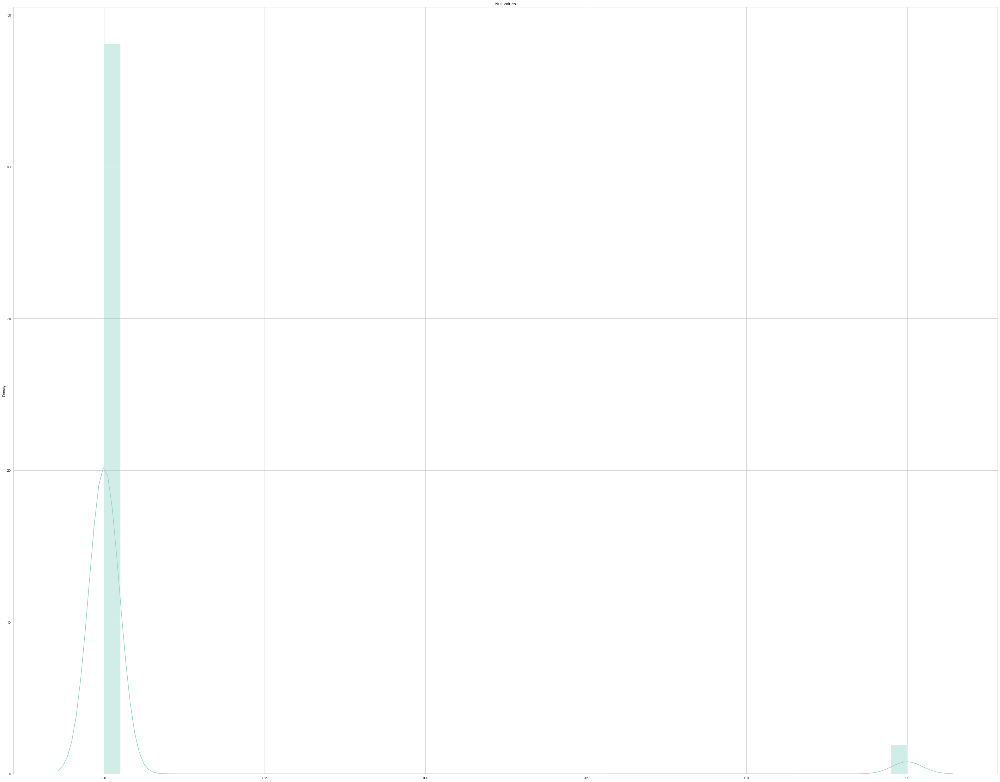

In [8]:
plt.figure(figsize=[50,40])
sns.distplot(df.isnull())
plt.title('Null values')
plt.show()

Based on this Visualization we can assume that NAN values are in the same row, now we will show those missing values using pandas and find any relation


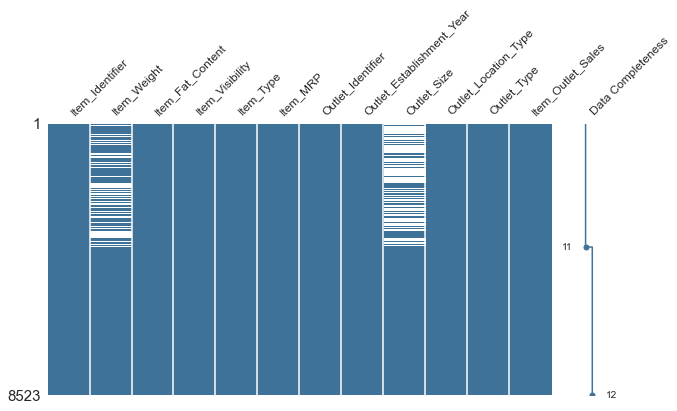

In [9]:
msno.matrix(df, sparkline=True, figsize=(10,5), sort='ascending', fontsize=12, labels=True, color=(0.25, 0.45, 0.6))
print("Based on this Visualization we can assume that NAN values are in the same row, now we will show those missing values using pandas and find any relation")

In [10]:
df[df.isna().any(axis=1)]

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
7,FDP10,NaN,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,NaN,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,NaN,Tier 2,Supermarket Type1,4710.5350
18,DRI11,NaN,Low Fat,0.034238,Hard Drinks,113.2834,OUT027,1985,Medium,Tier 3,Supermarket Type3,2303.6680
21,FDW12,NaN,Regular,0.035400,Baking Goods,144.5444,OUT027,1985,Medium,Tier 3,Supermarket Type3,4064.0432
23,FDC37,NaN,Low Fat,0.057557,Baking Goods,107.6938,OUT019,1985,Small,Tier 1,Grocery Store,214.3876
25,NCD06,13.000,Low Fat,0.099887,Household,45.9060,OUT017,2007,NaN,Tier 2,Supermarket Type1,838.9080
28,FDE51,5.925,Regular,0.161467,Dairy,45.5086,OUT010,1998,NaN,Tier 3,Grocery Store,178.4344
29,FDC14,NaN,Regular,0.072222,Canned,43.6454,OUT019,1985,Small,Tier 1,Grocery Store,125.8362


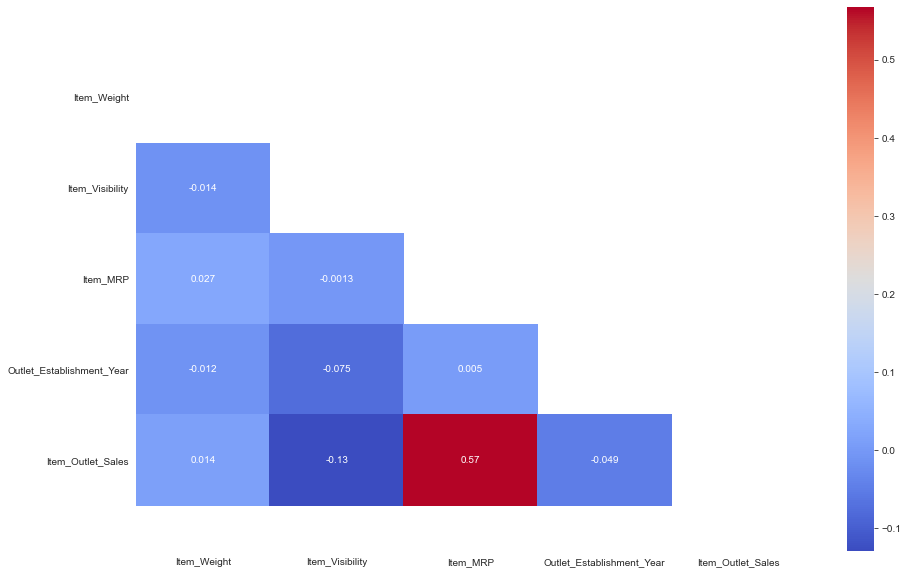

In [11]:
def corr (df):
    
    correlation = df.corr()
    f,ax= plt.subplots(figsize = (15,10))
    mask = np.triu(correlation)
    sns.heatmap(correlation, annot=True, mask=mask,ax=ax,cmap='coolwarm')
    bottom,top = ax.get_ylim()
    ax.set_ylim(bottom+ 0.5, top - 0.5)
    
corr(df)

In [12]:
for i in df.columns:
    value = df[i].isnull().sum()
    if value >0:
        print(i , "Missing Values",value)

Item_Weight Missing Values 1463
Outlet_Size Missing Values 2410


In [13]:
ndf = df[(df['Item_Weight'].notnull())&(df['Outlet_Size'].notnull())] 
dict_ndf = ndf.groupby(['Item_Identifier','Outlet_Size'])['Item_Weight'].mean().to_dict()


def finding_weights (col):
    model = col[0]
    measure = col[1]
    weight = col[2]
    
    for k, v in dict_ndf.items():
        if (k[0]==model) & (k[1]== measure):
            weight = v
        else :
            weight = weight 
            
    return weight

In [14]:
df['Item_Weight']= df[['Item_Identifier','Outlet_Size','Item_Weight']].apply(finding_weights,axis = 1)
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [15]:
grocery_index = df[(df['Outlet_Size'].isnull())&(df['Outlet_Type'] == 'Grocery Store')].index
df.loc[grocery_index,'Outlet_Size']="Small"

In [16]:
Out_no_NAN = df.loc[(df['Outlet_Size'].notna())&(df['Outlet_Size'] =='Small')][['Item_Identifier','Outlet_Size']].value_counts().to_frame().reset_index()
values = list(zip(Out_no_NAN.Item_Identifier, Out_no_NAN.Outlet_Size))

In [17]:
def finding_size (col):
    item = col[0]
    outsize = col[1]
    
    if pd.isnull(outsize) :
        
        for i in values:
            if i[0] == item:
                outsize = i[1]
        return outsize 

    else:
        return outsize

In [18]:
df['Outlet_Size']= df[['Item_Identifier','Outlet_Size']].apply(finding_size,axis = 1)


print("Replacing Values Under 2 Condition- 1.Item name, 2. Outlet_size\nReplacing!!!\n")
print("After Checking Out_size and Grouping by Outlet_Type I can noticed that All outlet_size in Grocery Store are small\nReplacing Nan for Small in outlet_size for Grocery Store!!")
df.head(5)

Replacing Values Under 2 Condition- 1.Item name, 2. Outlet_size
Replacing!!!

After Checking Out_size and Grouping by Outlet_Type I can noticed that All outlet_size in Grocery Store are small
Replacing Nan for Small in outlet_size for Grocery Store!!


,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [19]:
for i in df.columns:
    value = df[i].isnull().sum()
    if value >0:
        print(i , "Missing Values",value)

Item_Weight Missing Values 244
Outlet_Size Missing Values 113


In [20]:
index_weight = df.loc[df['Item_Weight'].isna()].index
index_size = df.loc[df['Outlet_Size'].isna()].index

In [21]:
df.drop(index_weight, inplace = True)
df.reset_index(drop=True)

df.drop(index_size, inplace = True)
df.reset_index(drop=True)

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,19.000,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,Small,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,Small,Tier 2,Supermarket Type1,4710.5350


In [22]:
def changing(x):
    
    if x == 'LF':
        x = 'Low Fat'
    elif x == 'low fat':
        x = 'Low Fat'
    elif x == 'reg':
        x = 'Regular'
    else:
        x=x
    return x

df['Item_Fat_Content'] = df['Item_Fat_Content'].apply(lambda x: changing(x))

df

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528
7,FDP10,19.000,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,Small,Tier 2,Supermarket Type1,1076.5986
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,Small,Tier 2,Supermarket Type1,4710.5350


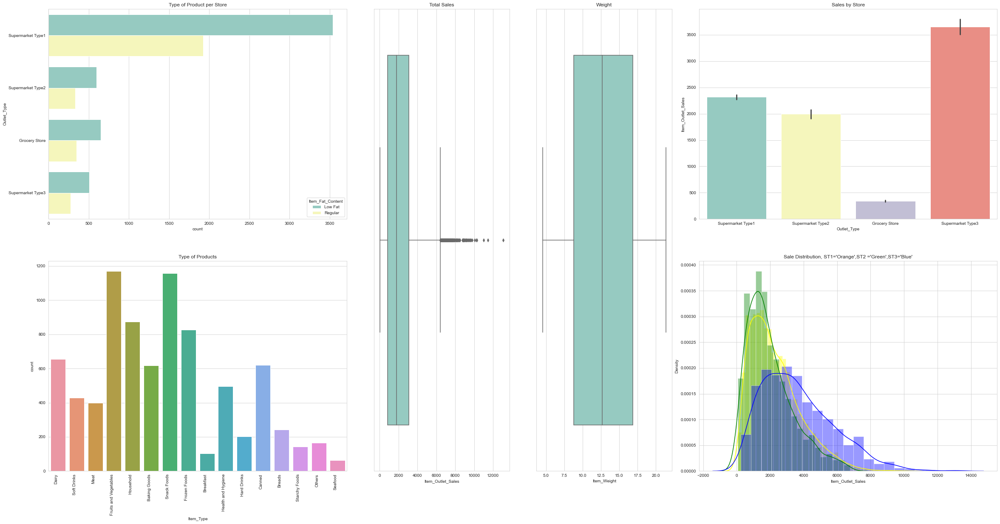

In [23]:
fig = plt.figure(constrained_layout=True, figsize=(40,20))
grid = gridspec.GridSpec(ncols=6, nrows=2, figure=fig)


ax1 = fig.add_subplot(grid[0, :2])
ax1.set_title('Type of Product per Store')
sns.countplot(y='Outlet_Type',hue = 'Item_Fat_Content',data = df, ax=ax1)


ax2 = fig.add_subplot(grid[1, :2])
ax2.set_title('Type of Products')
bar = sns.countplot(x='Item_Type', data = df, ax = ax2)
bar.set_xticklabels(bar.get_xticklabels(),  rotation=90, horizontalalignment='right')

ax3 = fig.add_subplot(grid[:, 2])
ax3.set_title('Total Sales')
sns.boxplot(df.loc[:,'Item_Outlet_Sales'], orient='v', ax = ax3)


ax4 = fig.add_subplot(grid[:,3])
ax4.set_title("Weight")
sns.boxplot(df['Item_Weight'], orient='v' ,ax=ax4)


ax5 = fig.add_subplot(grid[0, 4:6])
ax5.set_title("Sales by Store")
sns.barplot(x='Outlet_Type', y='Item_Outlet_Sales',data=df,ax=ax5) 


ax6 = fig.add_subplot(grid[1, 4:6])
ax6.set_title("Sale Distribution, ST1='Orange',ST2 ='Green',ST3='Blue'")
SuperT1 = df[df['Outlet_Type']=='Supermarket Type1']
SuperT2 = df[df['Outlet_Type']=='Supermarket Type2']
SuperT3 = df[df['Outlet_Type']=='Supermarket Type3']
Grocery = df[df['Outlet_Type']=='Grocery Store']

sns.distplot(SuperT1['Item_Outlet_Sales'], color = 'yellow', ax=ax6)
sns.distplot(SuperT2['Item_Outlet_Sales'], color = 'Green', ax=ax6)
sns.distplot(SuperT3['Item_Outlet_Sales'], color = 'Blue', ax=ax6)


plt.show()

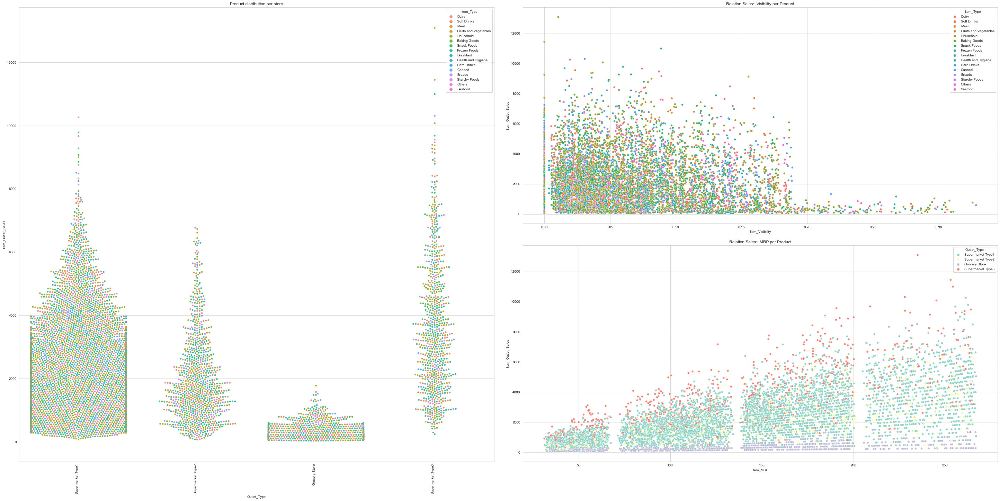

Low Fat is the category that performance better in sales , no matter the Store
Top 5 items : Fruit and vegetables, Snack Foods, Baking food, Frozen foods , Dairy
Average Sale in this data ser was almost 2000
Average Weight 12.5
Supermarket Type 3 perfomance better in sales 
In ST1(Green) seems to sell many product which the price range is 0~2500
In ST3(Blue) seems to sell many product which the price range is 2500~7500
The most expensive items are in ST1, however the one who has more products in ST1
There is no relation between Sales and Visibility but there is between MRP and Sales


In [24]:
fig = plt.figure(constrained_layout=True, figsize=(40,20))
grid = gridspec.GridSpec(ncols=2, nrows=2, figure=fig)

ax1 = fig.add_subplot(grid[0:, :1])
ax1.set_title('Product distribution per store')
distr=sns.swarmplot(x='Outlet_Type', y='Item_Outlet_Sales', hue='Item_Type' ,data=df,ax=ax1)
distr.set_xticklabels(distr.get_xticklabels(),  rotation=90, horizontalalignment='right')

ax2 = fig.add_subplot(grid[0, 1:])
ax2.set_title('Relation Sales~ Visibility per Product')
sns.scatterplot(y='Item_Outlet_Sales' ,x= 'Item_Visibility',  hue = 'Item_Type', data =df ,cmap='Spectral')

ax3 = fig.add_subplot(grid[1, 1:])
ax3.set_title('Relation Sales~ MRP per Product')
sns.scatterplot(y ='Item_Outlet_Sales', x = 'Item_MRP',data= df, hue = 'Outlet_Type', ax=ax3)
plt.show()


print("Low Fat is the category that performance better in sales , no matter the Store")
print("Top 5 items : Fruit and vegetables, Snack Foods, Baking food, Frozen foods , Dairy")
print("Average Sale in this data ser was almost 2000")
print("Average Weight 12.5")
print("Supermarket Type 3 perfomance better in sales ")
print("In ST1(Green) seems to sell many product which the price range is 0~2500\nIn ST3(Blue) seems to sell many product which the price range is 2500~7500")
print("The most expensive items are in ST1, however the one who has more products in ST1")
print("There is no relation between Sales and Visibility but there is between MRP and Sales")

In [25]:
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV,cross_val_score
from sklearn.preprocessing import MinMaxScaler,LabelEncoder,OneHotEncoder
from sklearn.metrics import mean_squared_error

In [26]:
def Outliers (data,column):
    mean_ = data[column].mean()
    Sdev_= data[column].std()
    Upper_limit= mean_+ (3*Sdev_)
    lower_limit= mean_- (3*Sdev_) #error 
    out= data[(data[column]>Upper_limit)|(data[column]<lower_limit)].index
    
       
    data.drop(out ,inplace=True)
    data.reset_index(drop= True)
    print(out)


In [27]:
df.drop(['Item_Identifier','Outlet_Identifier'], axis = 1 , inplace= True)
Outliers(df,"Item_Outlet_Sales")
df.head(5)

Int64Index([ 130,  145,  243,  275,  276,  304,  333,  373,  456,  661,  694,
             753,  809,  935,  991,  997, 1092, 1138, 1254, 1450, 1506, 1859,
            1998, 2109, 2216, 2516, 2535, 2776, 3083, 3087, 3098, 3154, 3213,
            3234, 3255, 3286, 3667, 3709, 3720, 3757, 4289, 4346, 4349, 4676,
            4772, 4888, 4961, 4991, 5065, 5177, 5185, 5315, 5550, 5619, 5752,
            5799, 6000, 6334, 6409, 6537, 6541, 6606, 6886, 6993, 7016, 7076,
            7188, 7191, 7256, 7302, 7343, 7560, 7562, 7609, 7752, 7816, 7826,
            7967, 8039, 8201, 8245, 8350, 8447],
           dtype='int64')


,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,9.30,Low Fat,0.016047,Dairy,249.8092,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,5.92,Regular,0.019278,Soft Drinks,48.2692,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,17.50,Low Fat,0.016760,Meat,141.6180,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,1998,Small,Tier 3,Grocery Store,732.3800
4,8.93,Low Fat,0.000000,Household,53.8614,1987,High,Tier 3,Supermarket Type1,994.7052


In [28]:
LE = LabelEncoder()
df['Outlet_Size']=LE.fit_transform(df['Outlet_Size'])

In [29]:
En = pd.get_dummies(df['Item_Fat_Content'], drop_first = True, prefix = 'LF')

In [30]:
df.drop(['Item_Type','Outlet_Location_Type','Outlet_Type','Item_Fat_Content'],axis = 1 , inplace=True) 

In [31]:
df = pd.concat([df,En],axis = 1 )
df.reset_index(drop=True)

df.head(5)

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Outlet_Size,Item_Outlet_Sales,LF_Regular
0,9.30,0.016047,249.8092,1999,1,3735.1380,0
1,5.92,0.019278,48.2692,2009,1,443.4228,1
2,17.50,0.016760,141.6180,1999,1,2097.2700,0
3,19.20,0.000000,182.0950,1998,2,732.3800,1
4,8.93,0.000000,53.8614,1987,0,994.7052,0


In [32]:
X = df.drop('Item_Outlet_Sales',axis= 1)
y = np.log1p(df["Item_Outlet_Sales"])

 
MN = MinMaxScaler()
X = MN.fit_transform(X)


Lnr = LinearRegression()
SVR_rbf = SVR(kernel = 'linear')
DT = DecisionTreeRegressor()
RDF = RandomForestRegressor()
XR = XGBRegressor()

 

model_list = [Lnr,DT,RDF,XR,SVR_rbf]

def best_ml (model,X,y,cv=10): 
    cross = -cross_val_score(model,X,y,cv=cv,scoring='neg_mean_squared_error').mean()
    final = np.sqrt(cross)
    final_score.append(final)
    
final_score = []


In [33]:
for i in model_list:
    best_ml(i,X,y)

pd.DataFrame(data = final_score,
             columns = ['mean_Squared_error'],
             index = ['LinearRegression','SupVecMach','DecisionTree','RandomForest','XGBRegressor'])

,mean_Squared_error
LinearRegression,0.801197
SupVecMach,0.749035
DecisionTree,0.556124
RandomForest,0.555698
XGBRegressor,0.833365


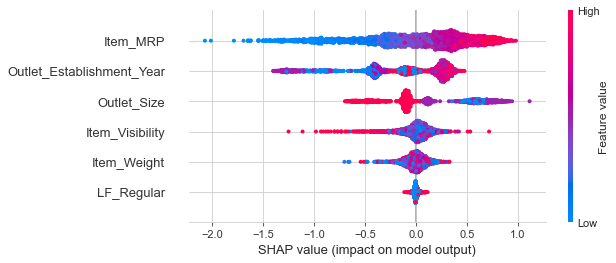

In [34]:
from sklearn.inspection import permutation_importance
import shap

name = df.drop('Item_Outlet_Sales',axis = 1)
pd.DataFrame(data = X, columns =name.columns)
X = name
y = np.log1p(df["Item_Outlet_Sales"])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
SVR_rbf = SVR(kernel = 'linear')

XGB = XGBRegressor()
XGB = XGB.fit(X_test,y_test)

perm_importance = permutation_importance(XGB, X_test, y_test)
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test)

In [35]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

SVR_rbf = SVR(kernel = 'linear')
XR = XGBRegressor()

In [36]:
param_grid = {'C' :[0.1,1,10,100,1000], 'gamma' : [1,0.1,0.01,0.001,0.0001]}
grid = GridSearchCV(SVR_rbf , param_grid , verbose = 3 , n_jobs = -1)
grid.fit(X_train,y_train)

Fitting 5 folds for each of 25 candidates, totalling 125 fits


GridSearchCV(estimator=SVR(kernel='linear'), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'gamma': [1, 0.1, 0.01, 0.001, 0.0001]},
             verbose=3)

In [37]:
SVR_y_pred = grid.predict(X_test)

In [38]:
n_estimators = [100,500,900,1100,1500]
max_depth = [2,3,5,10,15]
booster = ['gbtree', 'gblinear']
learning_rate = [0.05,0.1,0.15,0.20]
min_child_weight = [1,2,3,4]
base_score = [0.25,0.5,0.75,1]

In [39]:
hyperparameter_grid = { 'n_estimators': n_estimators,'max_depth': max_depth,'booster': booster,
                       'learning_rate': learning_rate,'min_child_weight': min_child_weight,
                       'base_score' : base_score}
random_cv = RandomizedSearchCV(estimator = XR,
                              param_distributions=hyperparameter_grid,
                              cv=5,n_iter = 50,
                              scoring = 'neg_mean_absolute_error',n_jobs = -1,
                              verbose = 5,
                              return_train_score=True,
                              random_state=42)

random_cv.fit(X_train,y_train)

Fitting 5 folds for each of 50 candidates, totalling 250 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, gamma=None,
                                          gpu_id=None, importance_type='gain',
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=None,
                                          n_estimators=100, n...
                                          validate_parameters=None,
                                          verbosity=None),
                   n_iter=50, n_jobs=-1,
                   par

In [40]:
XR_y_pred = random_cv.predict(X_test)

In [41]:
print("Mean Squared Error in SVM",np.sqrt(mean_squared_error(y_test,SVR_y_pred)))
print("Mean Squared Error in XGBoost",np.sqrt(mean_squared_error(y_test,XR_y_pred)))

Mean Squared Error in SVM 0.8076907939623365
Mean Squared Error in XGBoost 0.5185949500105997
